This notebook contains plots for dissolved phase and particulate phase from 1968-2008.

In [191]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

In [192]:
import netCDF4 as nc
import matplotlib.pyplot as plt
import numpy as np
import copy
import os
import glob
import pylab as pl
import numpy as np
import matplotlib.animation as animation
import types
from mpl_toolkits.basemap import cm,addcyclic,Basemap, shiftgrid
import matplotlib.patches as patches
% matplotlib inline

In [193]:
nc_filename=sorted(glob.glob('/ocean/xiaoxiny/research/result_jasper/min_ice/nasaRun/Y*2008*.nc'))#*_ptrc_T*.nc'))
print("found *.nc file: \n{}".format(nc_filename))
ptrc=nc.Dataset(nc_filename[0])

found *.nc file: 
['Y19682008.nc']


In [194]:
lon=ptrc.variables['nav_lon'][:,:]
lat=ptrc.variables['nav_lat'][:,:]
dep = ptrc.variables['deptht'][:]


tmask=nc.Dataset(
        '/ocean/xiaoxiny/research/NEMO-code/NEMOGCM/CONFIG/myANHA/EXP00/crop.nc')
mbathy=tmask.variables['mbathy'][0,400:,:]
tmask=tmask.variables['tmask'][0,:,400:,:]


bathy=nc.Dataset(
    '/ocean/xiaoxiny/research/data/Jasper/ANHA4_bathy_etopo1_gebco1_smoothed_coast_corrected_mar10.nc')
bathy=bathy.variables['Bathymetry'][400:,:]

In [195]:
yearnum=len(ptrc.variables['TR_7'][:,0,0,0])

# 1. dissolved phase

(39,)
0
1
2
0
1
2


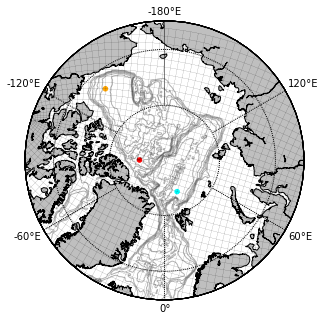

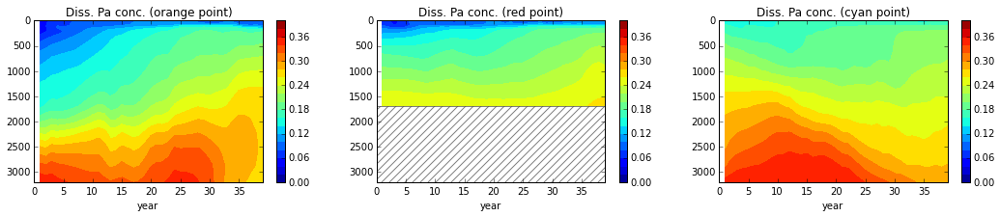

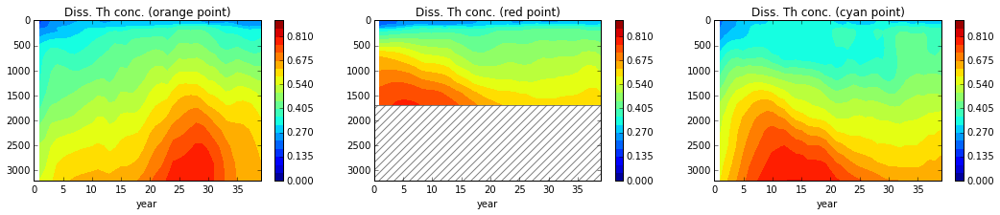

In [196]:
x=np.array([700-400,590-400,560-400])#/2
y=np.array([180,264,340])#/2
c=['orange','red','cyan']


time=np.empty(yearnum)
print time.shape
for i in range (len(time)):
    time[i]=i+1
    
    
fig = plt.figure(figsize=(5,10))
ax = fig.add_subplot()
m = Basemap(projection='npstere',boundinglat=65,lon_0=0,resolution='l',round='TRUE')
m.drawcoastlines()
m.fillcontinents(color = '0.75')
m.drawparallels(np.arange(-80.,80.,10.),labels=[1, 0, 0, 0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
x_lon,y_lat = m(lon,lat)
m.plot(x_lon[::10,::10],y_lat[::10,::10],x_lon.T[::10,::10],y_lat.T[::10,::10],color='k',linewidth=0.1)
m.scatter(x_lon[x,y],y_lat[x,y],color=c,s=20)
cs=m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.3)
#plt.clabel(cs, fontsize=10, inline=1,fmt = '%1.0f')


    
fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_7'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0, 0.4, 21))
    plt.colorbar()
    plt.title('Diss. Pa conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlim(1,len(time))
    plt.xlabel('year')
    ax.invert_yaxis()
    plt.xticks(np.arange(0, len(time)+1, 5))

 
    
fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_8'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0,0.9, 21))
    plt.colorbar()
    plt.title('Diss. Th conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlabel('year')
    ax.invert_yaxis() 
    plt.xticks(np.arange(0, len(time)+1, 5))

plt.show()

In [197]:
# find cross Canada profile (1)

x=np.array([720-400])
y=np.array([160])
a_=np.zeros([190,1])
b_=np.zeros([190,1])

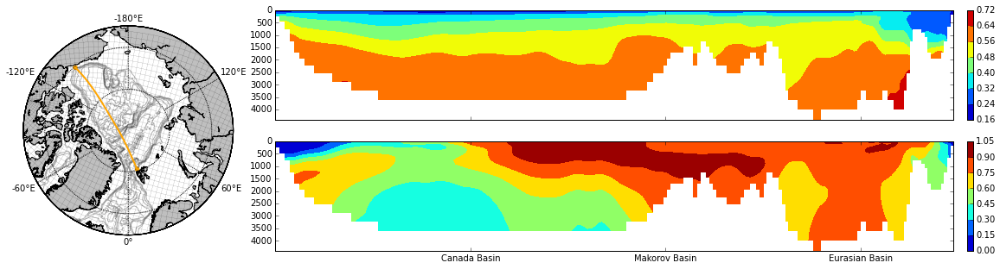

In [198]:
from matplotlib import gridspec

fig = plt.figure(figsize=(20,5))
gs = gridspec.GridSpec(2, 4)

# 1st plot
ax = fig.add_subplot(gs[0:2,0])

m = Basemap(projection='npstere',boundinglat=65,lon_0=0,resolution='l',round='TRUE')
m.drawcoastlines()
m.fillcontinents(color = '0.75')
m.drawparallels(np.arange(-80.,80.,10.),labels=[1, 0, 0, 0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
x_lon,y_lat = m(lon,lat)
m.plot(x_lon[::10,::10],y_lat[::10,::10],x_lon.T[::10,::10],y_lat.T[::10,::10],color='k',linewidth=0.1)
# find cross Canada profile (2)
for j in range (len (y)):
    a=[]
    b=[]
    for i in range (190):
        a.append(x_lon[x[j]-i,y[j]+i])
        b.append(y_lat[x[j]-i,y[j]+i])
    a_[:,j]=a
    b_[:,j]=b
    m.plot(a_[:,j],b_[:,j],color=c[j],linewidth=2)
m.scatter(a_[0],b_[0],color=c,s=20)
m.scatter(a_[-1],b_[-1],color=c,s=20)
m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.3)


#Final field
ax = fig.add_subplot(gs[0,1:4])
data_=np.zeros([50,190,len (y)])
for j in range (len (y)):
    for i in range (190):
        data_[:,i,j]=ptrc.variables['TR_8'][-1,:,x[j]-i,y[j]+i]
data_=np.ma.masked_where(data_<=0,data_)
plt.contourf(a_[:,j],dep[:-3],data_[:-3,:,0]);plt.colorbar(fraction=0.03,pad=0.02)
ax.invert_yaxis()
plt.xticks(np.arange(a_[:,0].min(), a_[:,0].max(),480000))
ax.get_xaxis().set_ticklabels([])

#initial field
ax = fig.add_subplot(gs[1,1:4])
data_=np.zeros([50,190,len (y)])
for j in range (len (y)):
    for i in range (190):
        data_[:,i,j]=ptrc.variables['TR_12'][-1,:,x[j]-i,y[j]+i]
data_=np.ma.masked_where(data_<=0,data_)
plt.contourf(a_[:,j],dep[:-3],data_[:-3,:,0],vmin=0,vmax=1);plt.colorbar(fraction=0.03,pad=0.02)
ax.invert_yaxis()
#change label for the bottom plot
plt.xticks(np.arange(a_[:,0].min(), a_[:,0].max(),480000))
a=ax.get_xticks().tolist()
a[0]='';a[1]='Canada Basin';a[2]='Makorov Basin';a[3]='Eurasian Basin'
ax.set_xticklabels(a)

plt.show()

# 1.1 diss Pa (cbar is different)

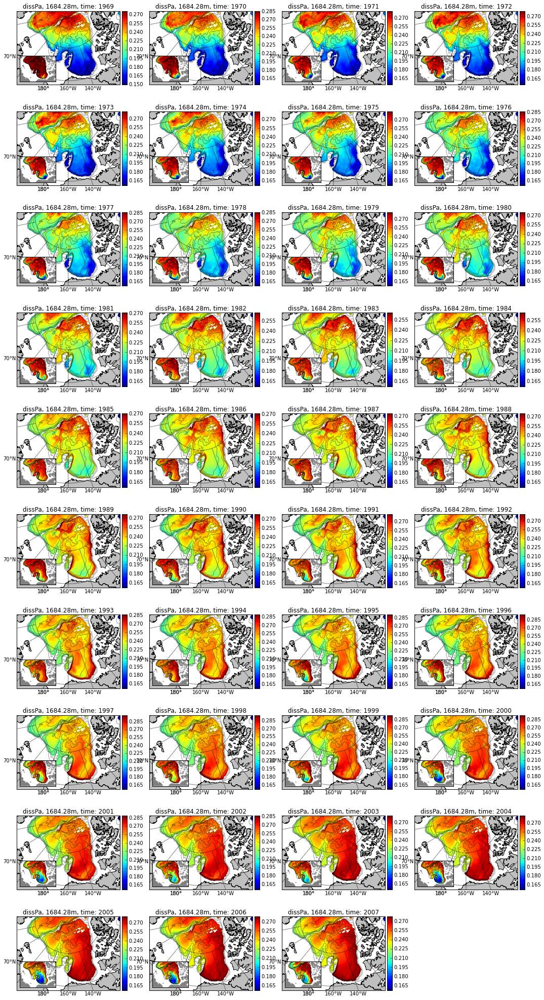

In [199]:
# tracer field at the current time step (TR_7)

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_7'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:]);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('dissPa, %sm, time: %s'%(dep[layer],1969+i))
    
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

# diss Pa (cbar is the same)

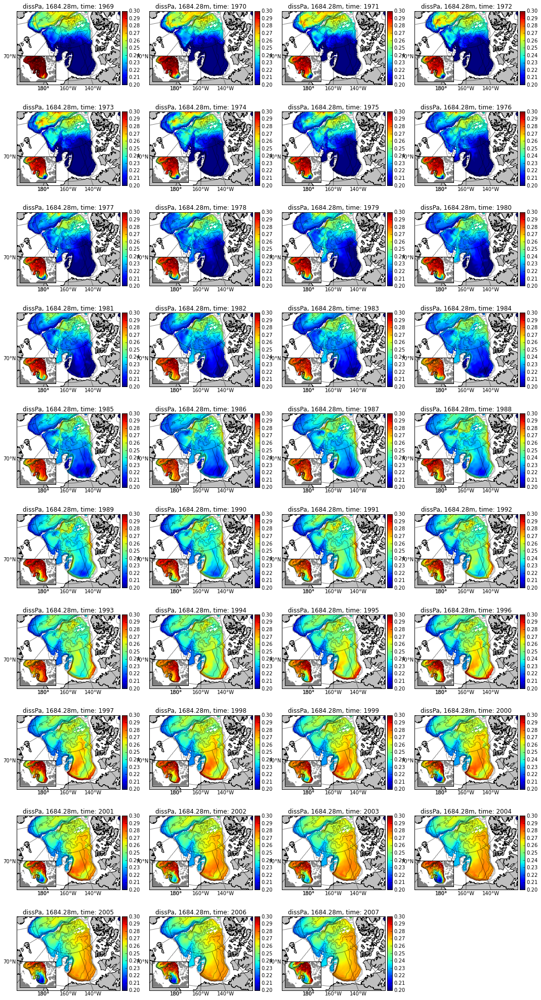

In [200]:
# tracer field at the current time step (TR_7)

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_7'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.2,vmax=0.3);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('dissPa, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

* Why do we have high conc. in the vortex??

# 1.2 diss pa analy solution

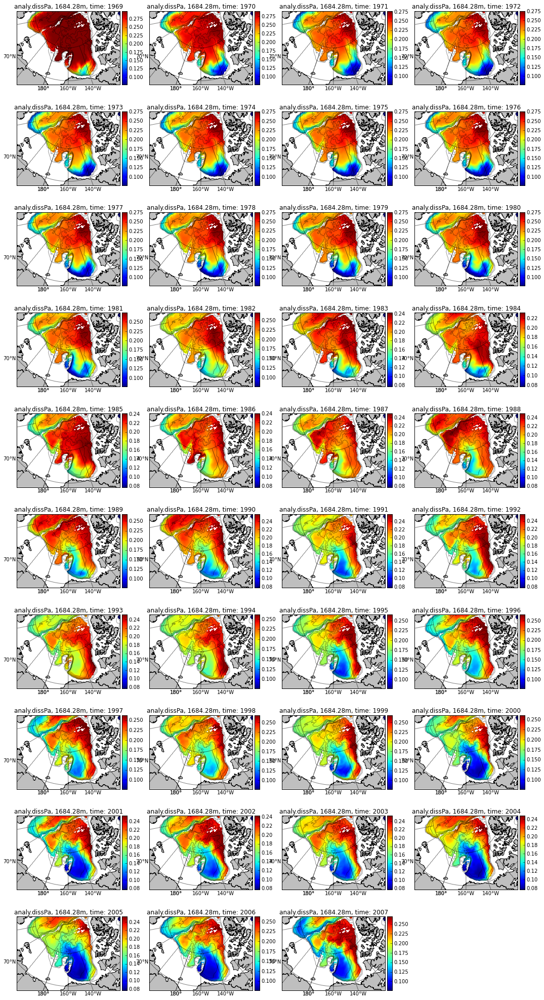

In [201]:
# plot analy. solution to understand the change above.

Q = 0.00246
k_de= 1.5


layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_11'][time,:,:,:]
    s = -508*data+1616
    k_ad = -0.055*data+0.082
    data = Q/k_ad + k_de/k_ad*(Q/s*dep[layer])
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:]);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('analy.dissPa, %sm, time: %s'%(dep[layer],1969+i))

plt.show()

# 1.3 diss Th

The trend of ice signal should be the same as the trend of diss. tracer concentrations.. Unlike the particulate phase (section 2), the dissolved phase is not responding very quickly to the change of the ice signal.

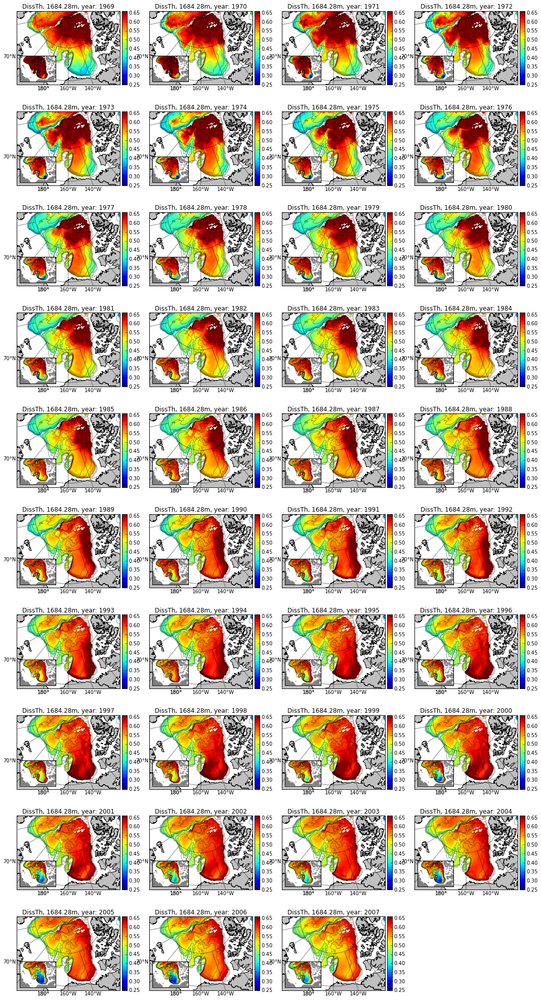

In [202]:
# tracer field at the current time step (TR_8)

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_8'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.25,vmax=0.66);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('DissTh, %sm, year: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

# 1.4 Pa/Th

/home/xiaoxiny/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: invalid value encountered in divide


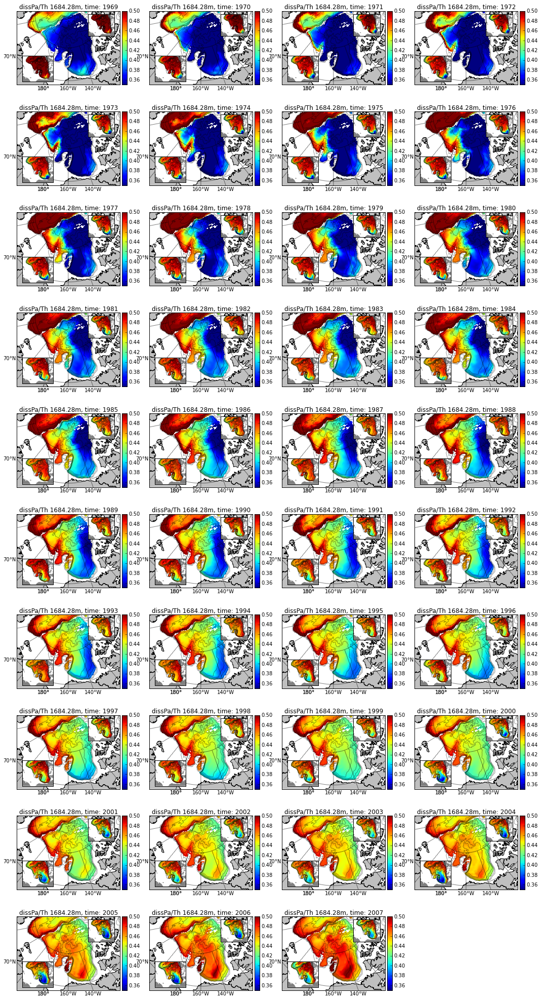

In [226]:
# Pa/Th

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_7'][time,:,:,:]/ptrc.variables['TR_8'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    data[:,:120,:] =np.ma.masked

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.35,vmax=0.50);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('dissPa/Th %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
                  
    
    # add inset
    axin_right = inset_axes(m.ax, width='30%', height='30%', loc=1)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)


plt.show()

# 2.particulate phase

(39,)
0
1
2
0
1
2


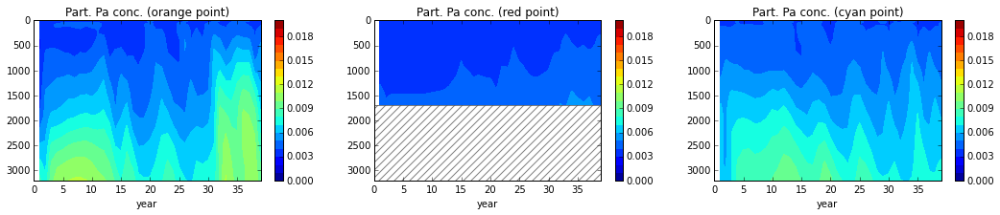

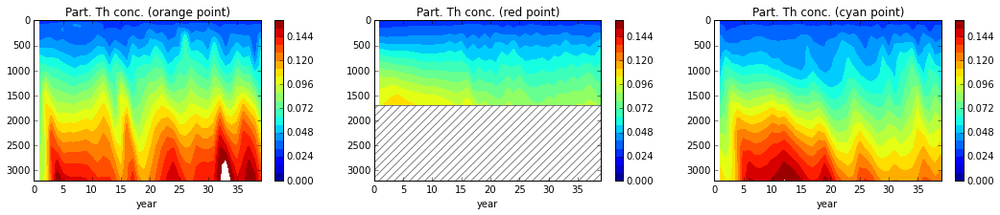

In [204]:
x=np.array([700-400,590-400,560-400])#/2
y=np.array([180,264,340])#/2
c=['orange','red','cyan']

time=np.empty(yearnum)
print time.shape
for i in range (len(time)):
    time[i]=i+1

fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_9'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0, 0.02, 21))
    plt.colorbar()
    plt.title('Part. Pa conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlim(1,len(time))
    plt.xlabel('year')
    ax.invert_yaxis()
    plt.xticks(np.arange(0, len(time)+1, 5))

 
    
fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    print i
    ax = fig.add_subplot(1,3,i+1)
    data=ptrc.variables['TR_10'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],data.T,np.linspace(0,0.16, 21))
    plt.colorbar()
    plt.title('Part. Th conc. (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlabel('year')
    ax.invert_yaxis() 
    plt.xticks(np.arange(0, len(time)+1, 5))

plt.show()

# part Pa

The ice signal affects the particulate phase field faster than the dissolved field.

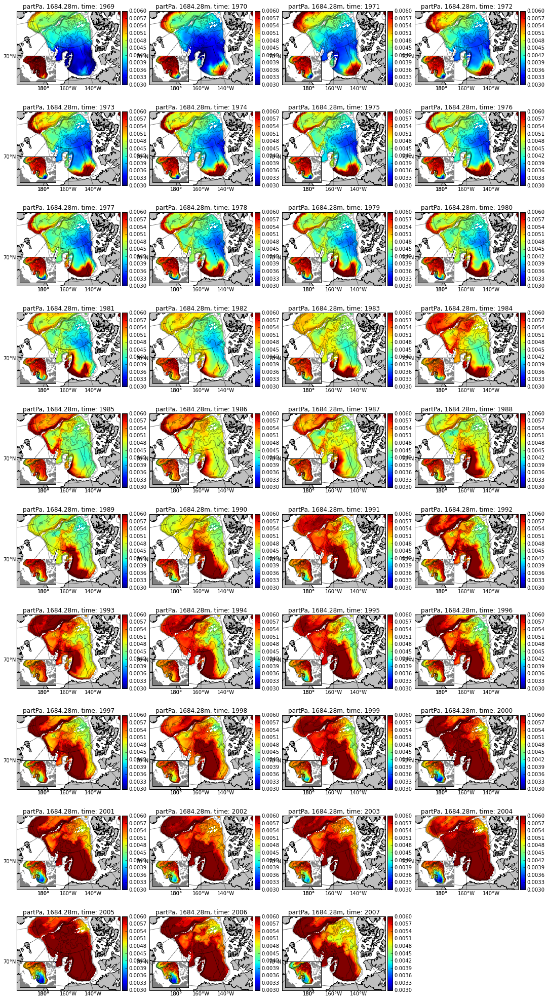

In [205]:
layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_9'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.003,vmax=0.006);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('partPa, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

Sum: For all the plots above, lower ice leads to higher tracer concentrations.

# part Th

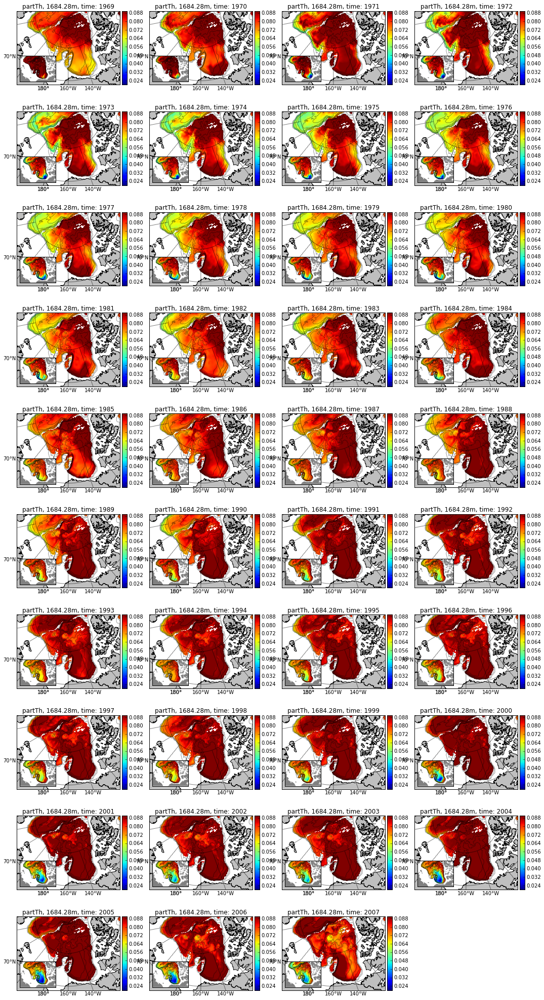

In [206]:
layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_10'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.02,vmax=0.09);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('partTh, %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)

plt.show()

/home/xiaoxiny/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: invalid value encountered in divide


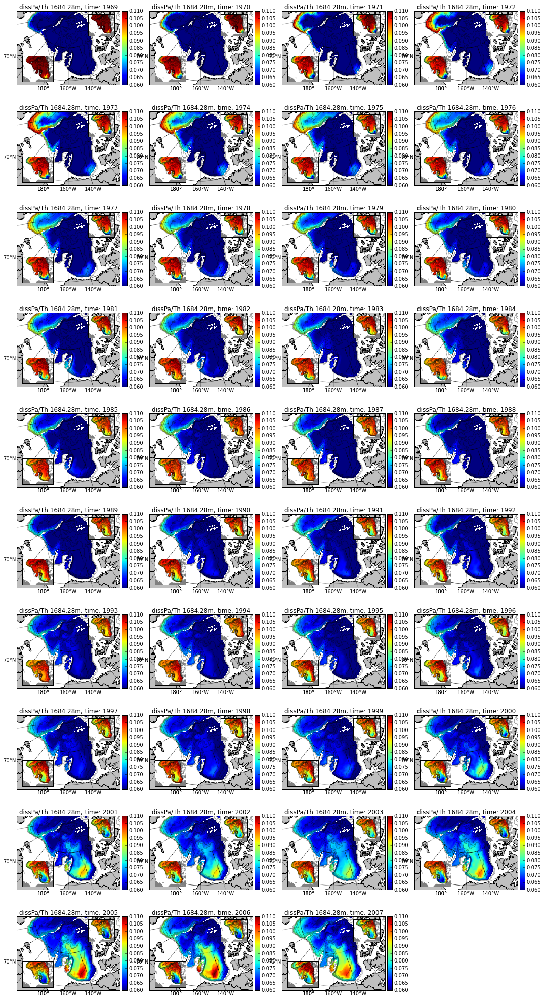

In [229]:
# Pa/Th

layer=38
k=0

fig = plt.figure(figsize=(18,35))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_9'][time,:,:,:]/ptrc.variables['TR_10'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    data[:,:120,:] =np.ma.masked

    k+=1

    ax = fig.add_subplot(10,4,k)
    #m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m = Basemap(width =3.5e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0.06,vmax=0.11);m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('dissPa/Th %sm, time: %s'%(dep[layer],1969+i))
    
    m.ax = ax
    # add inset

    axin = inset_axes(m.ax, width='35%', height='35%', loc=3)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
                  
    
    # add inset
    axin_right = inset_axes(m.ax, width='30%', height='30%', loc=1)

    inmap = Basemap(width =3e6,height =2.5e6,lon_0=-160, lat_0=80,
            projection='stere', resolution='l')
    inmap.fillcontinents('grey')
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)
    inmap.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1);
    inmap.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)


plt.show()

In [207]:
# ice conc. difference between initial field and final field.

(39,)


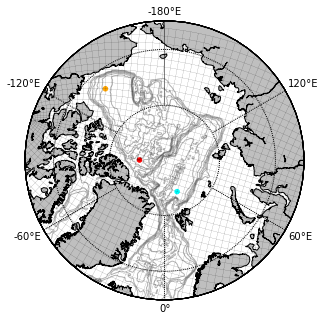

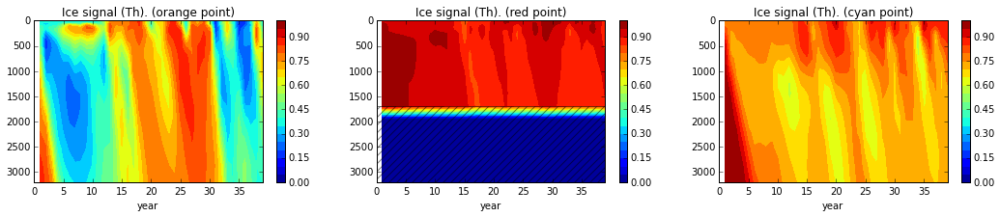

In [208]:
x=np.array([700-400,590-400,560-400])#/2
y=np.array([180,264,340])#/2
c=['orange','red','cyan']


time=np.empty(yearnum)
print time.shape
for i in range (len(time)):
    time[i]=i+1
    
    
fig = plt.figure(figsize=(5,10))
ax = fig.add_subplot()
m = Basemap(projection='npstere',boundinglat=65,lon_0=0,resolution='l',round='TRUE')
m.drawcoastlines()
m.fillcontinents(color = '0.75')
m.drawparallels(np.arange(-80.,80.,10.),labels=[1, 0, 0, 0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0, 0, 1, 1])
x_lon,y_lat = m(lon,lat)
m.plot(x_lon[::10,::10],y_lat[::10,::10],x_lon.T[::10,::10],y_lat.T[::10,::10],color='k',linewidth=0.1)
m.scatter(x_lon[x,y],y_lat[x,y],color=c,s=20)
cs=m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.3)
#plt.clabel(cs, fontsize=10, inline=1,fmt = '%1.0f')


    
fig = plt.figure(figsize=(18,3))
for i in range (len(y)):
    ax = fig.add_subplot(1,3,i+1)
    
    data=ptrc.variables['TR_12'][:,10:,x[i],y[i]]
    data=np.ma.masked_where(data<=0,data)
    ax.add_patch(patches.Rectangle((0, dep[mbathy[x[i],y[i]]-1]), len(time),3000,hatch='///',
                                   fill=False,alpha=0.5))
    
    plt.contourf(time[:],dep[10:],ptrc.variables['TR_12'][:,10:,x[i],y[i]].T,np.linspace(0, 1, 21))
    plt.colorbar()
    plt.title('Ice signal (Th). (%s point)'%c[i])
    plt.ylim(0,3200)
    plt.xlim(1,len(time))
    plt.xlabel('year')
    ax.invert_yaxis()
    plt.xticks(np.arange(0, len(time)+1, 5))

 
plt.show()

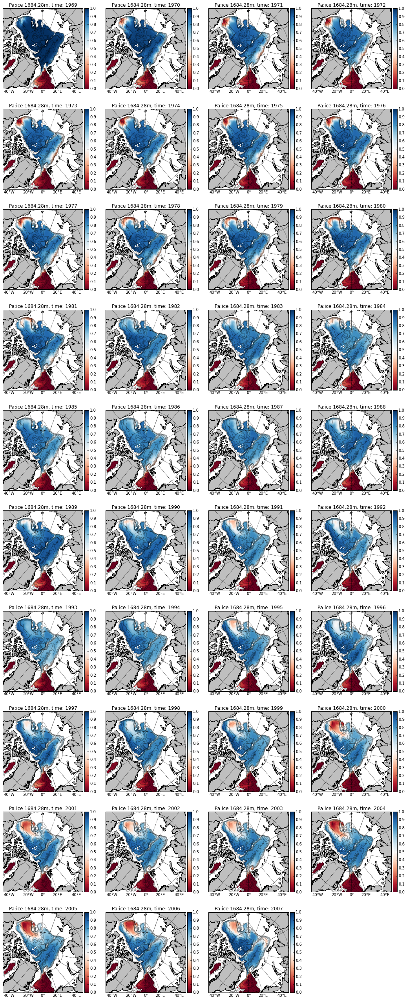

In [209]:
layer=38
k=0

fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_11'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmax=1,vmin=0,cmap='RdBu');m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('Pa:ice %sm, time: %s'%(dep[layer],1969+i))

plt.show()

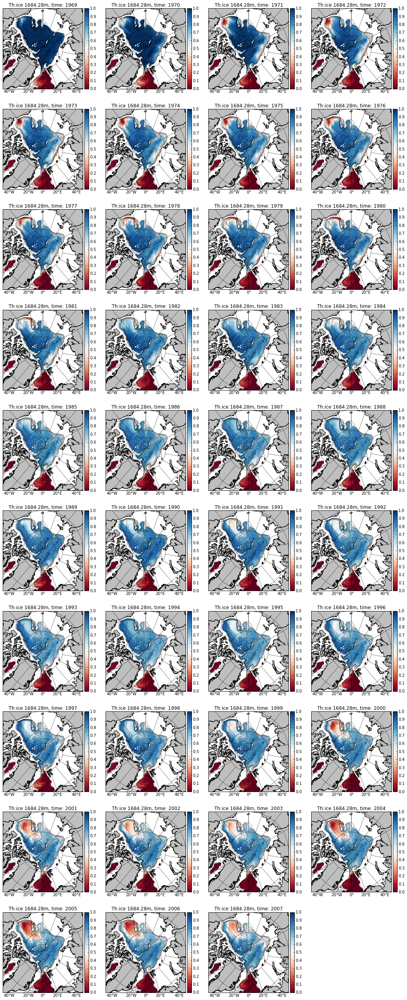

In [210]:
layer=38
k=0

fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmax=1,vmin=0,cmap='RdBu');m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title('Th:ice %sm, time: %s'%(dep[layer],1969+i))

plt.show()

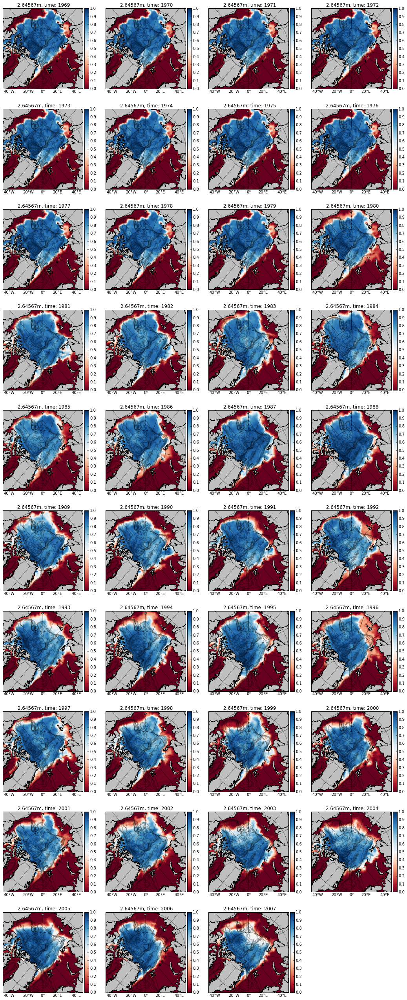

In [211]:
layer=2
k=0

fig = plt.figure(figsize=(18,45))
for i in range (0,yearnum,1):
    time =i
    data =ptrc.variables['TR_12'][time,:,:,:]#-TR_7[time,:,:,:]
    data =np.ma.masked_where(tmask==0,data)

    k+=1

    ax = fig.add_subplot(10,4,k)
    m = Basemap(projection='npstere',boundinglat=70,lon_0=0,resolution='l')
    m.drawcoastlines()
    m.fillcontinents(color = '0.75')
    m.drawparallels(np.arange(-80.,81.,10.),labels=[1, 0, 0, 0])
    m.drawmeridians(np.arange(-180.,181.,20.),labels=[0, 0, 0, 1])
    x_lon,y_lat = m(lon,lat)
    m.pcolor(x_lon,y_lat,data[layer,:,:],vmin=0,vmax=1,cmap='RdBu');m.colorbar()
    m = m.contour(x_lon,y_lat,bathy,linewidth=0.075,colors='black',alpha=0.4)
    plt.title(' %sm, time: %s'%(dep[layer],1969+i))

plt.show()